In [13]:
import time
import numpy as np
np.set_printoptions(precision=3)

In [14]:
rvecs = [np.array([[1,2,3]]), np.array([[4,5,6]]), np.array([[7,8,9]]),np.array([[-7,8,-9]]),np.array([[70,8,9]])]
print(rvecs)
rvecs_array = np.array(rvecs)
np.mean(rvecs_array, axis=0)

[array([[1, 2, 3]]), array([[4, 5, 6]]), array([[7, 8, 9]]), array([[-7,  8, -9]]), array([[70,  8,  9]])]


array([[15. ,  6.2,  3.6]])

## DH param and fk

In [15]:
dh_params = [
    (0, 0.2234, 0, np.pi / 2),
    (0 - np.pi / 2, 0, -0.280, 0),
    (0, 0, -0.225, 0),
    (0 - np.pi / 2, 0.1175, 0, np.pi / 2),
    (0, 0.120, 0, -np.pi / 2),
    (0, 0.088, 0, 0)
]

def dh_transform(theta, d, a, alpha):
    ct, st = np.cos(theta), np.sin(theta)
    ca, sa = np.cos(alpha), np.sin(alpha)
    return np.array([
        [ct, -st*ca, st*sa, a*ct],
        [st, ct*ca, -ct*sa, a*st],
        [0, sa, ca, d],
        [0, 0, 0, 1]
])

In [16]:
def fk(q, dh_params):
    T = np.eye(4)
    for i, (theta0, d, a, alpha) in enumerate(dh_params):
       T = T @ dh_transform(q[i] + theta0, d, a, alpha)
    return T
   #  p = T[:3, 3]
   #  R = T[:3, :3]
   #  return p, R

In [17]:
q = np.array([0, 0, -90, 0, 90, 90])
T = fk(q, dh_params)
print(T[:3, 3])
print(T[:3, :3])

[ 0.273 -0.078  0.278]
[[-0.709  0.58  -0.401]
 [ 0.401  0.799  0.448]
 [ 0.58   0.157 -0.799]]


## SO(3)

In [18]:
def log_so3(R):
    theta = np.arccos((np.trace(R) -1)/2)
    if abs(theta) < 1e-6:
        return np.zeros(3)
    else:
        w_hat = (R - R.T)/(2*np.sin(theta))
        w = np.array([w_hat[2,1], w_hat[0,2], w_hat[1,0]])
        if theta > np.pi:
            w *= (theta - 2 * np.pi) / theta
        return theta * w/np.linalg.norm(w)

def skew_symmetric(w):
    return np.array([[0, -w[2], w[1]], [w[2], 0, -w[0]], [-w[1], w[0], 0]])

def exp_so3(w):
    theta = np.linalg.norm(w)
    if theta < 1e-6:
        return np.eye(3)
    W = skew_symmetric(w/theta)
    R = np.eye(3) + np.sin(theta)*W + (1 - np.cos(theta))*(W@W)
    return R

In [19]:
R = np.array([[0, -1, 0],[1, 0, 0],[0,0,1]])
w = log_so3(R)
print(np.rad2deg(w))
R = exp_so3(w)
print(np.round(R,2))

[ 0.  0. 90.]
[[ 0. -1.  0.]
 [ 1.  0.  0.]
 [ 0.  0.  1.]]


## Jacobian with SO(3)

In [20]:
def compute_jacobian_so3(q, dh_params, delta=1e-6):
    n_joints = len(q)
    J = np.zeros((6, n_joints))
    T = fk(q, dh_params)
    p0 = T[:3, 3]
    R0 = T[:3, :3]
    for i in range(n_joints):
        q_perturbed = q.copy()
        q_perturbed[i] += delta
        T = fk(q_perturbed, dh_params)
        p1 = T[:3, 3]
        R1 = T[:3, :3]
        
        dp = (p1 - p0) / delta
        J[0:3, i] = dp
        
        R_error = R0.T@R1
        w = log_so3(R_error) / delta
        J[3:6, i] = w
    return J

## ik with SO(3)

In [21]:
def clik_so3(target_T, dh_params, q_init, max_iter=100, tol=1e-3):
    target_p = target_T[:3, 3]
    target_R = target_T[:3, :3]
    q = q_init.copy()
    q_history = [q.copy()]
    for i in range(max_iter):
        current_T = fk(q, dh_params)
        current_p = current_T[:3, 3]
        current_R = current_T[:3, :3]
        dp = target_p - current_p
        dR = current_R.T @ target_R
        dw = log_so3(dR)
        dx = np.concatenate((dp, dw))
        if np.linalg.norm(dx) < tol:
            print(f"IK solved!")
            return q, q_history
        J = compute_jacobian_so3(q, dh_params)
        J_pinv = np.linalg.pinv(J)
        dq = J_pinv @ dx
        q += np.clip(dq, -0.1, 0.1)
        q_history.append(q.copy())
    print("IK not solved.")
    return q, q_history

In [22]:
q_init = np.array([0, 0, -np.pi/2+0.3, 0, np.pi/2, np.pi/2])
target_T = fk(np.array([0, 0, -np.pi/2, 0, np.pi/2, np.pi/2]), dh_params)
target_p = target_T[:3, 3]
target_R = target_T[:3, :3]
q_ik, _ = clik_so3(target_T, dh_params, q_init)
T = fk(q_ik, dh_params)
result_p = T[:3, 3]
result_R = T[:3, :3]

print(f"target p : {target_p}")
print(f"result p : {result_p}")
print(f"target R : {target_R.round(2)}")
print(f"result R : {result_R.round(2)}")


IK solved!
target p : [ 0.345 -0.118  0.415]
result p : [ 0.345 -0.118  0.415]
target R : [[-1.  0.  0.]
 [-0.  1. -0.]
 [-0. -0. -1.]]
result R : [[-1.  0.  0.]
 [ 0.  1. -0.]
 [-0. -0. -1.]]


## Visualization

IK not solved.


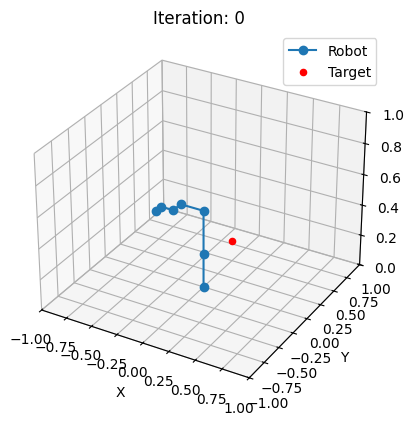

In [23]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def get_link_pos(q, dh_params):
    positions = [np.array([0,0,0])]
    T = np.eye(4)
    for i, (theta0, d, a, alpha) in enumerate(dh_params):
        T = T @ dh_transform(q[i] + theta0, d, a, alpha)
        pos = T[:3, 3].copy()
        positions.append(pos)
    return np.array(positions)

def visualize_robot(q_history, dh_params, target_p):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter([target_p[0]],[target_p[1]], [target_p[2]], color='r', label='Target')
    
    def update(frame):
        ax.cla()
        q = q_history[frame]
        positions = get_link_pos(q, dh_params)
        ax.plot(positions[:, 0], positions[:, 1], positions[:, 2], marker='o', label='Robot')
        ax.scatter([target_p[0]],[target_p[1]], [target_p[2]], color='r', label='Target')
        ax.set_xlim(-1, 1)
        ax.set_ylim(-1, 1)
        ax.set_zlim(0, 1)
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        ax.legend()
        ax.set_title(f"Iteration: {frame}")
    ani = FuncAnimation(fig, update, frames=len(q_history), interval=200, repeat=False)
    # plt.show()
    return ani

# q_init = np.array([np.pi/2, -1, -np.pi/2, 0, np.pi/2, np.pi/2])
q_init = np.array([0,0,np.pi/2,0,0,0])
target_T = fk(np.array([0, 0, -np.pi/2, 0, np.pi/2, np.pi/2]), dh_params)
q_ik, q_history = clik_so3(target_T, dh_params, q_init)
# print(q_history)
ani = visualize_robot(q_history, dh_params, target_p)
HTML(ani.to_jshtml())


## SE3

In [24]:
def exp_se3(xi):
    w, v = xi[:3], xi[3:]
    theta = np.linalg.norm(w)
    if theta < 1e-6:
        R = np.eye(3)
        V = np.eye(3)
    else:
        w_hat = w / theta
        W = skew_symmetric(w_hat)
        R = np.eye(3) + np.sin(theta) * W + (1 - np.cos(theta)) * (W @ W)
        V = np.eye(3) + (1 - np.cos(theta)) / theta * W + (theta - np.sin(theta)) / theta**2 * (W @ W)
    p = V @ v
    T = np.eye(4)
    T[:3, :3], T[:3, 3] = R, p
    return T

def log_se3(T):
    R, p = T[:3, :3], T[:3, 3]
    theta = np.arccos(np.clip((np.trace(R) - 1) / 2, -1.0, 1.0))
    if abs(theta) < 1e-6:
        w, v = np.zeros(3), p
    else:
        w_hat = (R - R.T) / (2 * np.sin(theta))
        w = theta * np.array([w_hat[2, 1], w_hat[0, 2], w_hat[1, 0]])
        W = skew_symmetric(w / theta)
        V = np.eye(3) + (1 - np.cos(theta)) / theta * W + (theta - np.sin(theta)) / theta**2 * (W @ W)
        V_inv = np.linalg.inv(V)
        v = V_inv @ p
    
    return np.concatenate([w, v])

In [25]:
T = np.array([[0, -1, 0, 1],[1, 0, 0, 1],[0, 0, 1, 1], [0, 0, 0, 1]])
xi = log_se3(T)
print(np.rad2deg(xi[:3]))
T_dash = exp_se3(xi)
print(np.round(T_dash, 2))

[ 0.  0. 90.]
[[ 0. -1.  0.  1.]
 [ 1.  0.  0.  1.]
 [ 0.  0.  1.  1.]
 [ 0.  0.  0.  1.]]


## Jacobian with SE(3)

In [26]:
def compute_jacobian_se3(q, dh_params, delta=1e-6):
    n_joints = len(q)
    J = np.zeros((6, n_joints))
    T0 = fk(q, dh_params)
    for i in range(n_joints):
        q_perturbed = q.copy()
        q_perturbed[i] += delta
        T1 = fk(q_perturbed, dh_params)
        T_error = np.linalg.inv(T0) @ T1
        xi = log_se3(T_error) / delta
        J[:, i] = xi
    return J

In [27]:
def clik_se3(target_T, dh_params, q_init, max_iter=100, tol=2e-3):
    q = q_init.copy()
    q_history = [q.copy()]
    for i in range(max_iter):
        current_T = fk(q, dh_params)
        dT = np.linalg.inv(current_T) @ target_T
        xi = log_se3(dT)
        if np.linalg.norm(xi) < tol:
            print(f"IK solved!")
            return q, q_history
        J = compute_jacobian_se3(q, dh_params)
        J_pinv = np.linalg.pinv(J)
        dq = J_pinv @ xi
        q += np.clip(dq, -0.1, 0.1)
        q_history.append(q.copy())
    print("IK not solved.")
    return q, q_history

IK not solved.


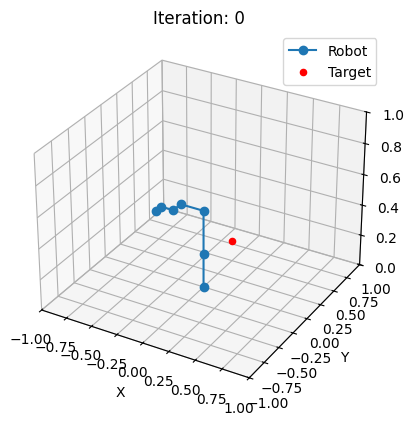

In [28]:
q_init = np.array([0.0,0,np.pi/2,0,0,0])
target_T = fk(np.array([0, 0, -np.pi/2, 0, np.pi/2, np.pi/2]), dh_params)
q_se3, q_se3_history = clik_se3(target_T, dh_params, q_init)
ani_se3 = visualize_robot(q_se3_history, dh_params, target_p)
HTML(ani_se3.to_jshtml())


In [45]:
# q_so3_ik, q_so3_history = clik_so3(target_T, dh_params, q_init)
# ani_so3 = visualize_robot(q_so3_history, dh_params, target_p)
# HTML(ani_so3.to_jshtml())


## IK with damping least squares

In [46]:
def clik_dls(target_T, dh_params, q_init, lambda_sq = 0.0001, max_iter=100, tol=1e-3):
    q = q_init.copy()
    q_history = [q.copy()]
    for i in range(max_iter):
        T_current = fk(q, dh_params)
        T_error = np.linalg.inv(T_current) @ target_T
        xi = log_se3(T_error)
        if np.linalg.norm(xi) < tol:
            print("IK solved!")
            return q, q_history
        J = compute_jacobian_se3(q, dh_params)
        J_pinv_dls = J.T @ np.linalg.inv(J @ J.T + lambda_sq * np.eye(6))
        dq = J_pinv_dls @ xi
        q += np.clip(dq, -0.1, 0.1)
        q_history.append(q.copy())
    print("IK not solved.")
    return q, q_history

IK solved!
calc time: 0.10407233238220215


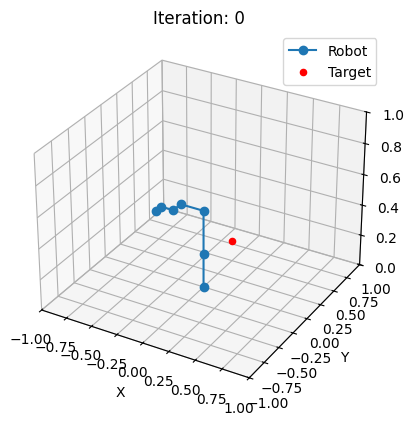

In [47]:
start = time.time()
q_dls, q_dls_history = clik_dls(target_T, dh_params, q_init)
stop = time.time()
print(f"calc time: {stop - start}")
anim_dls = visualize_robot(q_dls_history, dh_params, target_p)
HTML(anim_dls.to_jshtml())

## IK with gradient decent

In [48]:

def ik_gd(target_T, dh_params, q_init, max_iter=100, tol=1e-3, alpha = 0.001):
    q = q_init.copy()
    q_history = [q.copy()]
    for i in range(max_iter):
        T_current = fk(q, dh_params)
        T_error = np.linalg.inv(T_current) @ target_T
        xi = log_se3(T_error)
        cost = np.linalg.norm(xi)**2
        if cost < tol:
            print("IK solved!")
            return q, q_history
        J = compute_jacobian_se3(q, dh_params)
        grad = 2 * J.T @xi
        q -= alpha * grad
        q = np.clip(q, -np.pi, np.pi)
        q_history.append(q.copy())
    else:
        print("IK not solved.")
        return q, q_history

IK not solved.
101


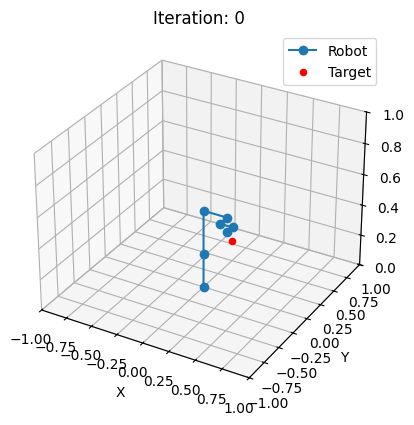

In [38]:
q_gd, q_gd_history = ik_gd(target_T, dh_params, q_init)
print(len(q_gd_history))
anim_gd = visualize_robot(q_gd_history, dh_params, target_p)
HTML(anim_gd.to_jshtml())